# Annotations using clustering for cells for skin_s4

In [1]:
slide_id = "skin_s4"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_skin_s4.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 35787, 18669), (3, 17894, 9335)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (109795, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (109795, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (109795, 5006)
      └── 'table_nuclei': AnnData (109795, 7638)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 109795 × 5006
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,nucleus_count,segmentation_method,region,z_level
0,aaaaaaaa-1,2445,0,0,0,0,30,2475,489.719549,70.082503,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
1,aaaaaaab-1,2658,0,1,0,0,16,2675,333.162825,58.522502,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
2,aaaaaaac-1,1747,0,0,0,0,8,1755,254.274853,43.485470,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
3,aaaaaaad-1,1877,0,0,0,1,33,1911,332.666106,13.908126,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
9,aaaaaaae-1,1075,0,0,0,0,11,1086,199.184226,43.124220,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112546,aaabkmno-1,16,0,0,0,0,0,16,6.276719,6.276719,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,4.0
112547,aaabkmnp-1,9,0,0,0,0,0,9,10.250469,10.250469,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0
112548,aaabkmoa-1,10,0,0,0,0,0,10,17.701251,17.701251,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,4.0
112549,aaabkmob-1,139,0,0,0,0,0,139,65.115315,27.816251,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2ML1,ENSG00000166535,Gene Expression,Unknown
AAMP,ENSG00000127837,Gene Expression,Unknown
AAR2,ENSG00000131043,Gene Expression,Unknown
AARSD1,ENSG00000266967,Gene Expression,Unknown
ABAT,ENSG00000183044,Gene Expression,Unknown
...,...,...,...
ZSCAN26,ENSG00000197062,Gene Expression,Unknown
ZSWIM6,ENSG00000130449,Gene Expression,Unknown
ZUP1,ENSG00000153975,Gene Expression,Unknown
ZYG11B,ENSG00000162378,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 103216 × 7638
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,67.711847,Arterial EC,571,6,10,13,13,Keratinocyte,Keratinocyte,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,55.994183,Spinous keratinocyte,1051,6,10,13,13,Keratinocyte,Keratinocyte,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,41.317727,Spinous keratinocyte,581,6,10,13,13,Keratinocyte,Keratinocyte,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,12.508198,Arterial EC,88,6,10,13,13,Keratinocyte,Keratinocyte,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,41.024334,Granular keratinocyte,256,6,10,13,13,Keratinocyte,Keratinocyte,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabkmnn-1,nucleus_boundaries,morpho,aaabkmnn-1,13.480007,Memory B,36,1,1,0,0,T,T_CD8,normal_cell
aaabkmno-1,nucleus_boundaries,morpho,aaabkmno-1,5.418354,Merkel cell carcinoma enriched epithelial cell,15,1,1,5,5,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell
aaabkmoa-1,nucleus_boundaries,morpho,aaabkmoa-1,16.165430,Merkel cell carcinoma enriched epithelial cell,11,1,1,5,5,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell
aaabkmob-1,nucleus_boundaries,morpho,aaabkmob-1,26.145439,NK cell,94,1,1,0,0,T,T_CD8,normal_cell


In [9]:
adata_nuclei.var

,mean,std
A2ML1,0.029212,0.336316
AAMP,0.247654,0.914380
AAR2,0.064026,0.485089
AARSD1,0.124239,0.649109
ABAT,0.015443,0.250172
...,...,...
ZSCAN26,0.081884,0.543178
ZSWIM6,0.028859,0.329659
ZUP1,0.047480,0.422838
ZYG11B,0.058482,0.459199


## 2. Preprocessing

<Axes: >

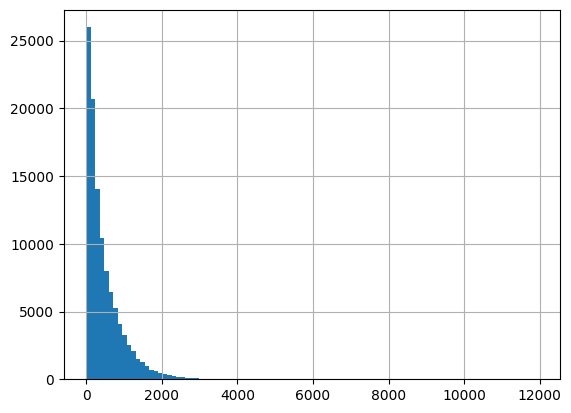

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

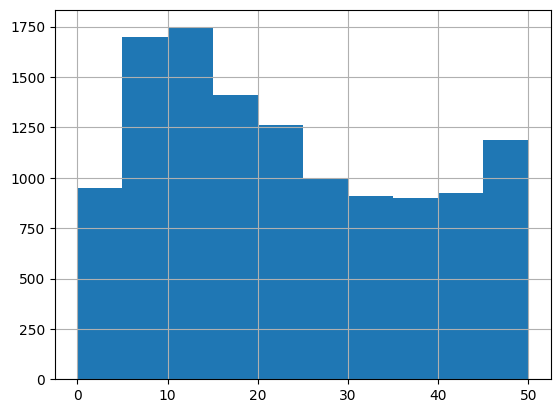

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 5804
Percentage of cells with less than 20 transcripts: 5.29%
-----
Number of cells with less than 15 transcripts: 4393
Percentage of cells with less than 15 transcripts: 4.0%
-----
Number of cells with less than 10 transcripts: 2646
Percentage of cells with less than 10 transcripts: 2.41%
-----
Number total of cells: 109795


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

106783


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


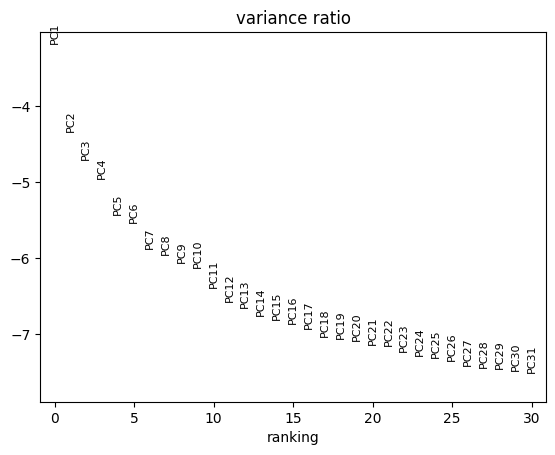

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 106783 × 5006
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_2583/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


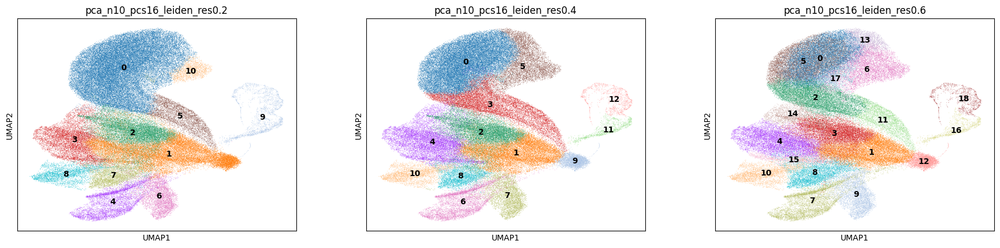

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].unique()

['9', '2', '1', '0', '3', ..., '8', '4', '7', '10', '5']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [42]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['10']), 'refine_res'] = '10'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '11'

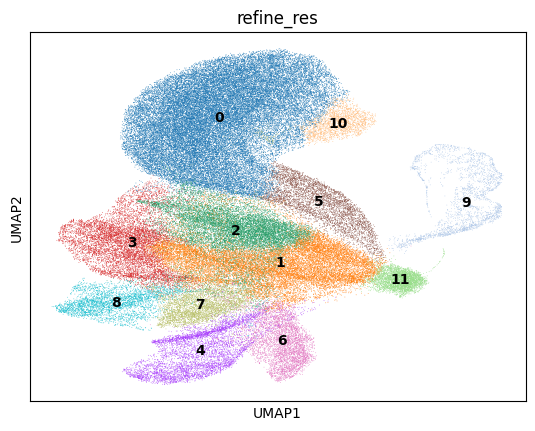

In [43]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [44]:
clustering_label = 'refine_res'

In [45]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

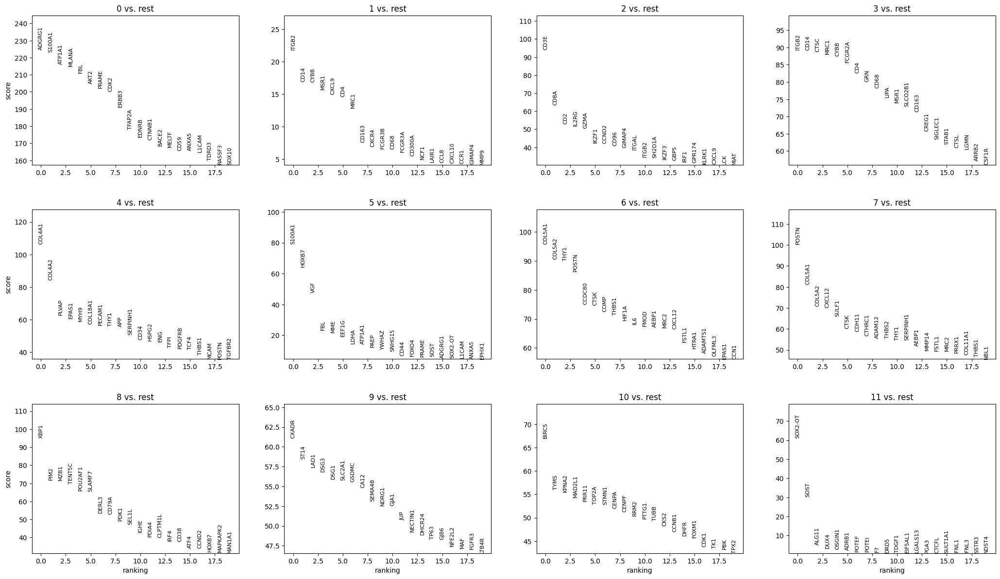

In [46]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [47]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [48]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [49]:
cluster_id = '0'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Melanoma,Melanoma,cancer_cell,91.3
1,Melanoma,High_proliferating_melanoma,cancer_cell,6.4
2,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,0.7
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.7
4,T,T_CD8,normal_cell,0.5


In [51]:
top_ranked_genes[cluster_id]

0    ADGRG1
1    S100A1
2    ATP1A1
3     MLANA
4       FBL
5      AKT2
6     PRAME
Name: 0, dtype: object

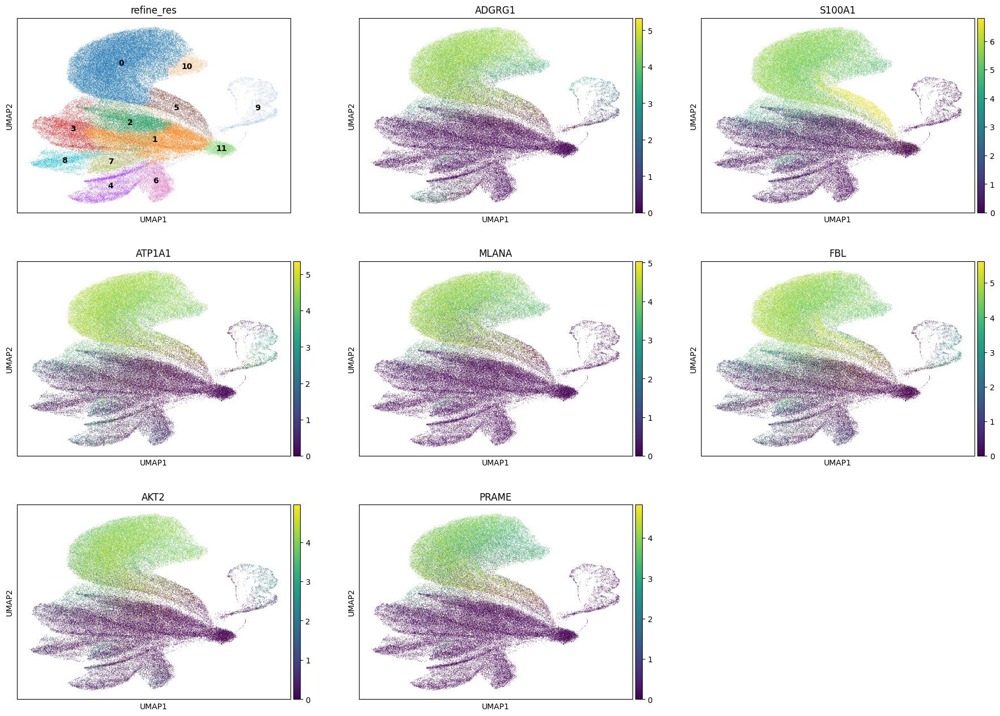

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 39914
Percentage of cells in cluster 0: 37.4


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.2. Cluster 1

In [55]:
cluster_id = '1'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,43.3
1,T,T_CD8,normal_cell,24.6
2,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,13.9
3,NA,NA,NA,10.3
4,Fibroblast,Fibroblast,normal_cell,3.9


In [57]:
top_ranked_genes[cluster_id]

0    ITGB2
1     CD14
2     CYBB
3     MSR1
4    CXCL9
5      CD4
6     MRC1
Name: 1, dtype: object

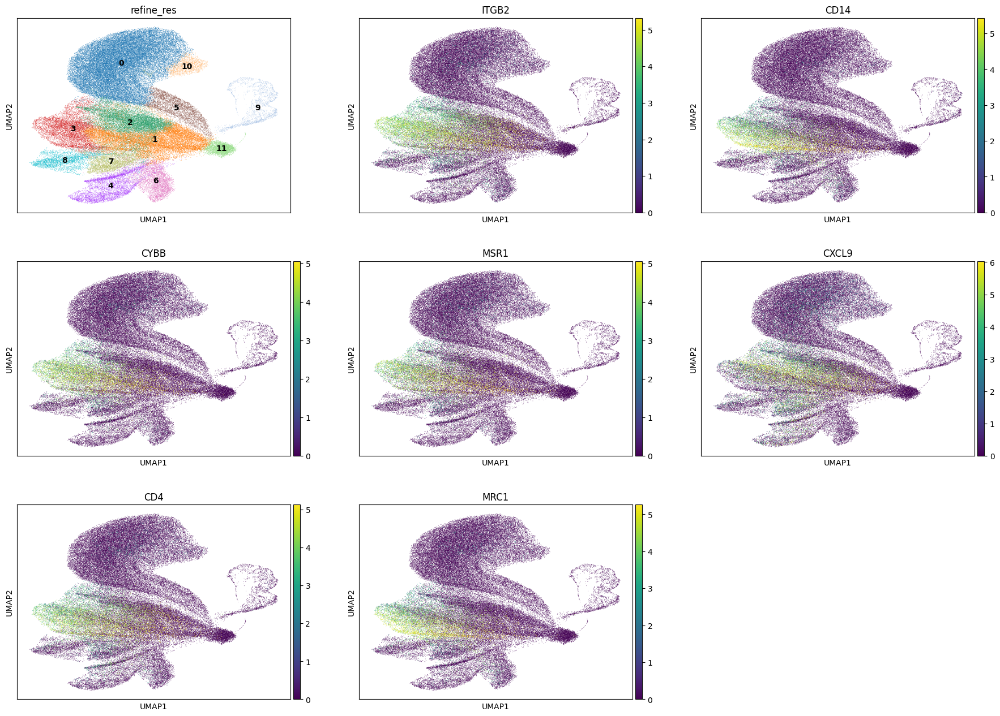

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 16565
Percentage of cells in cluster 1: 15.5


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.3. Cluster 2

In [61]:
cluster_id = '2'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T_CD8,normal_cell,82.4
1,T/NK,Proliferating_T_NK,normal_cell,7.4
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,4.5
3,Melanoma,Melanoma,cancer_cell,1.7
4,Fibroblast,Fibroblast,normal_cell,1.5


In [63]:
top_ranked_genes[cluster_id]

0     CD3E
1     CD8A
2      CD2
3    IL2RG
4     GZMA
5    IKZF1
6    CCND2
Name: 2, dtype: object

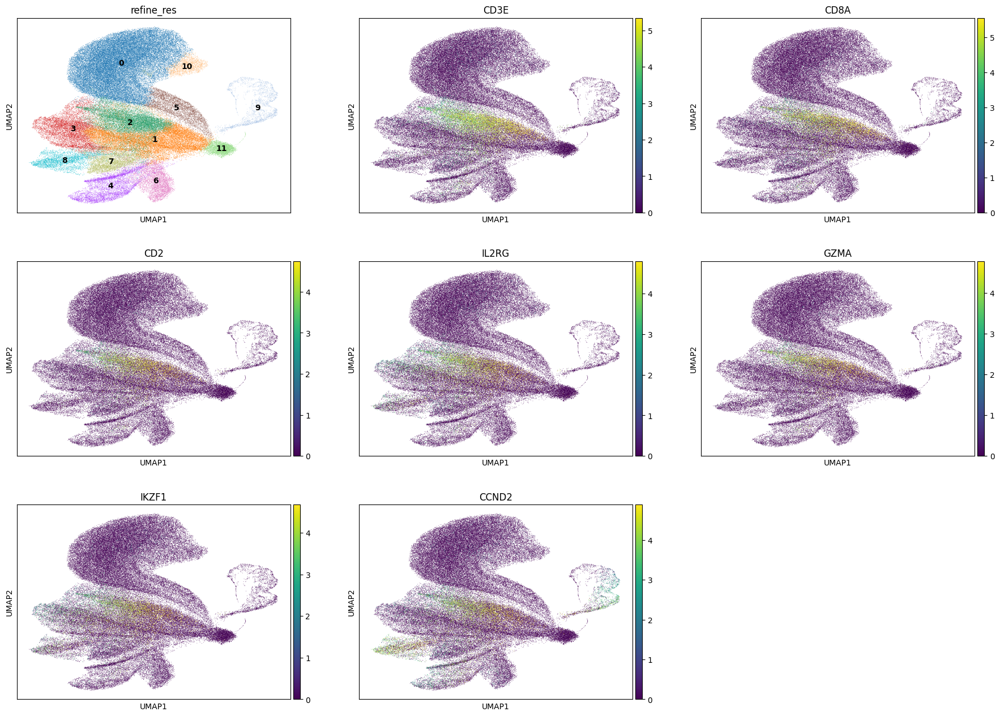

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 12139
Percentage of cells in cluster 2: 11.4


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.4. Cluster 3

In [67]:
cluster_id = '3'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,94.0
1,T,T_CD8,normal_cell,1.7
2,Melanoma,Melanoma,cancer_cell,1.7
3,Fibroblast,Fibroblast,normal_cell,1.3
4,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,0.5


In [69]:
top_ranked_genes[cluster_id]

0     ITGB2
1      CD14
2      CTSC
3      MRC1
4      CYBB
5    FCGR2A
6       CD4
Name: 3, dtype: object

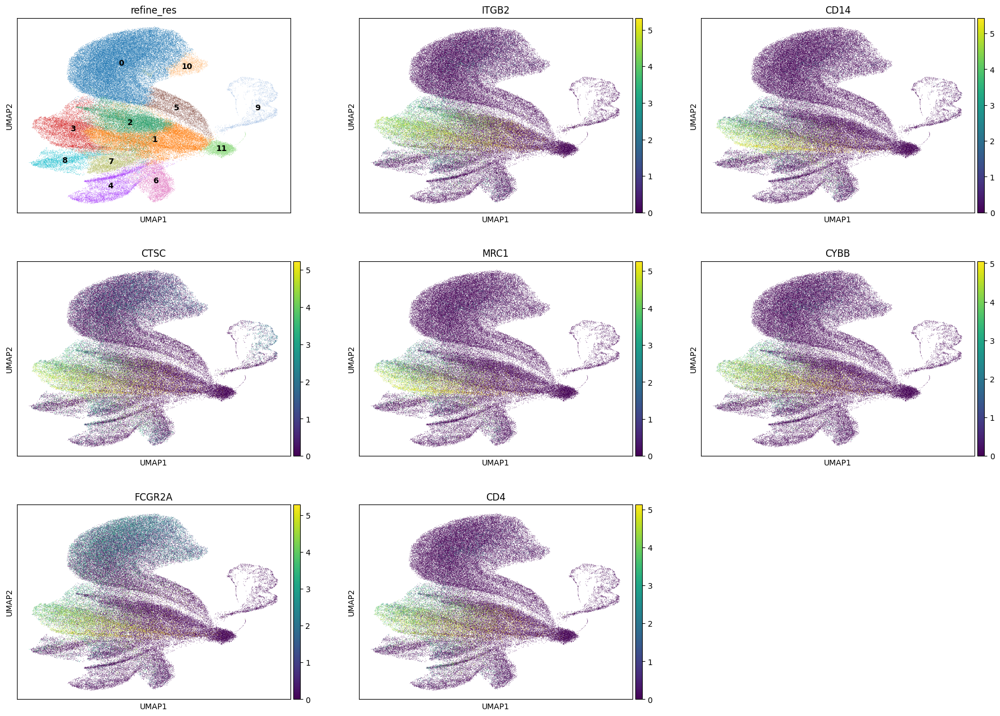

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 8054
Percentage of cells in cluster 3: 7.5


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.5. Cluster 4

In [73]:
cluster_id = '4'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,52.7
1,Perivascular,Smooth_muscle_and_pericyte,normal_cell,36.0
2,T,T_CD8,normal_cell,4.3
3,Fibroblast,Fibroblast,normal_cell,2.3
4,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,1.9


In [75]:
top_ranked_genes[cluster_id]

0     COL4A1
1     COL4A2
2      PLVAP
3      EPAS1
4       MYH9
5    COL18A1
6     PECAM1
Name: 4, dtype: object

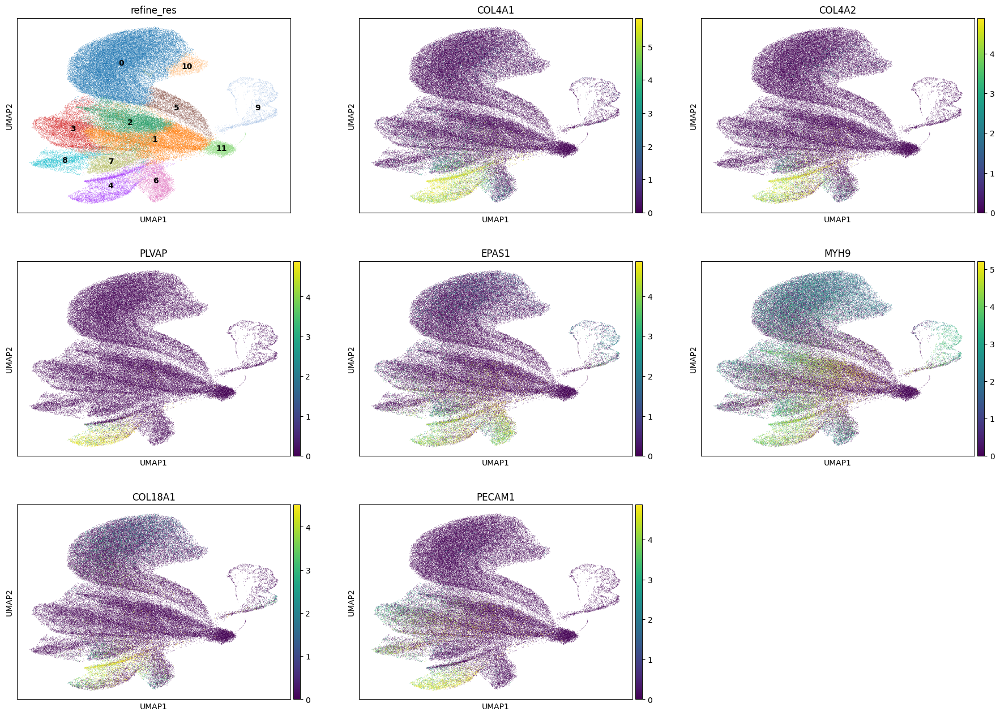

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 5321
Percentage of cells in cluster 4: 5.0


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.6. Cluster 5

In [79]:
cluster_id = '5'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Melanoma,Melanoma,cancer_cell,52.4
1,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,39.3
2,NA,NA,NA,6.7
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.9
4,T,T_CD8,normal_cell,0.6


In [81]:
top_ranked_genes[cluster_id]

0    S100A1
1     HOXB7
2       VGF
3       FBL
4       MME
5     EEF1G
6      LDHA
Name: 5, dtype: object

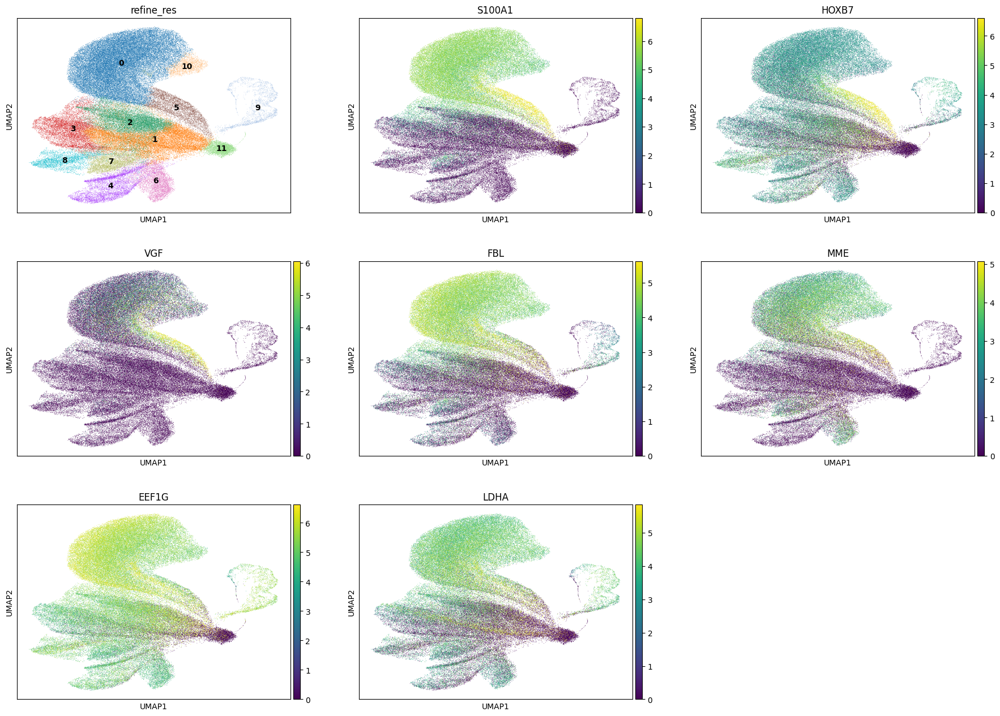

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 4532
Percentage of cells in cluster 5: 4.2


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.7. Cluster 6

In [85]:
cluster_id = '6'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,88.7
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,4.9
2,T,T_CD8,normal_cell,1.8
3,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,1.6
4,Perivascular,Smooth_muscle_and_pericyte,normal_cell,1.2


In [87]:
top_ranked_genes[cluster_id]

0    COL5A1
1    COL5A2
2      THY1
3     POSTN
4    CCDC80
5      CTSK
6      COMP
Name: 6, dtype: object

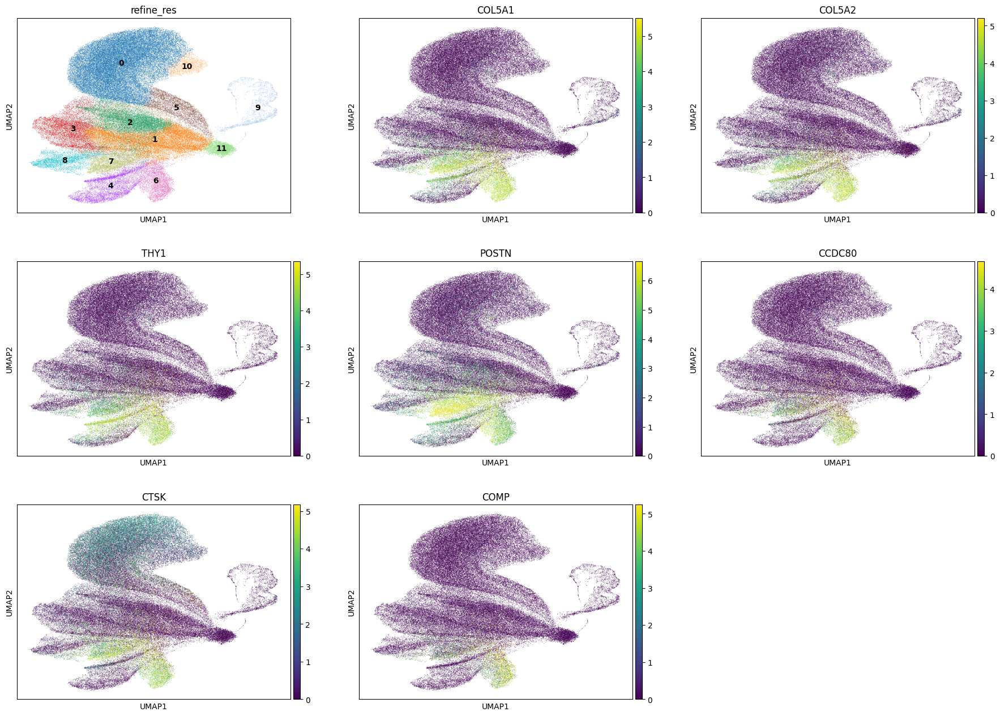

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 4503
Percentage of cells in cluster 6: 4.2


In [90]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.8. Cluster 7

In [91]:
cluster_id = '7'

In [92]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,74.4
1,T,T_CD8,normal_cell,9.7
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,9.6
3,Melanoma,Melanoma,cancer_cell,2.0
4,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,1.8


In [93]:
top_ranked_genes[cluster_id]

0     POSTN
1    COL5A1
2    COL5A2
3    CXCL12
4     SULF1
5      CTSK
6     CDH11
Name: 7, dtype: object

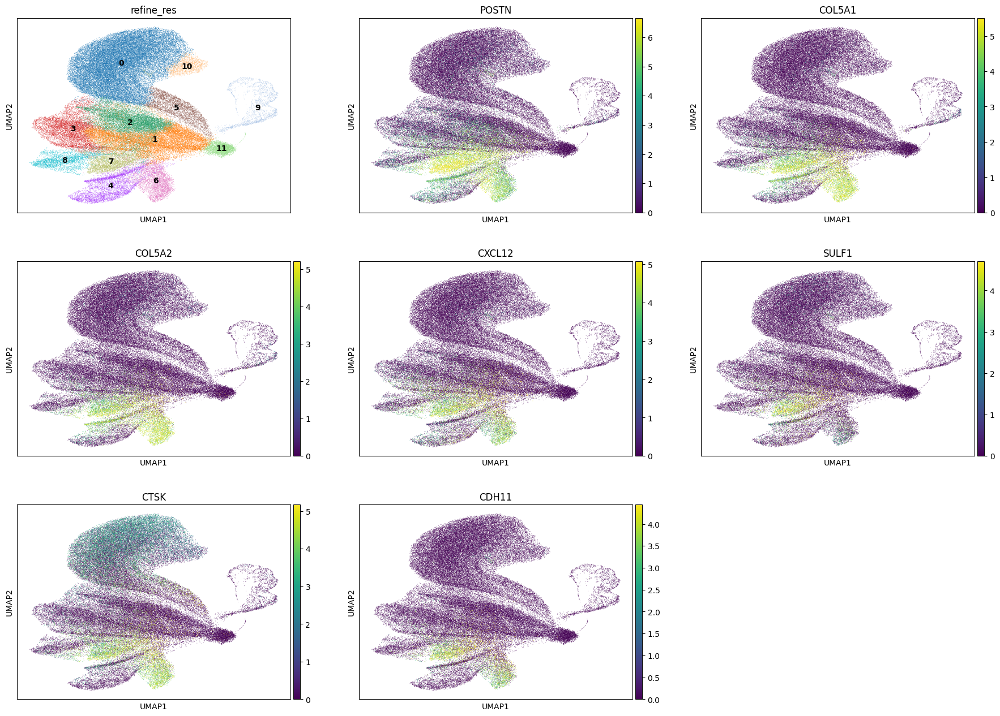

In [94]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [95]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 4068
Percentage of cells in cluster 7: 3.8


In [96]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast/Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast/Myofibroblast'

### 5.9. Cluster 8

In [97]:
cluster_id = '8'

In [98]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,89.5
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,2.5
2,T,T_CD8,normal_cell,2.4
3,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,2.1
4,Fibroblast,Fibroblast,normal_cell,2.0


In [99]:
top_ranked_genes[cluster_id]

0       XBP1
1       PIM2
2       MZB1
3     TENT5C
4    POU2AF1
5     SLAMF7
6      DERL3
Name: 8, dtype: object

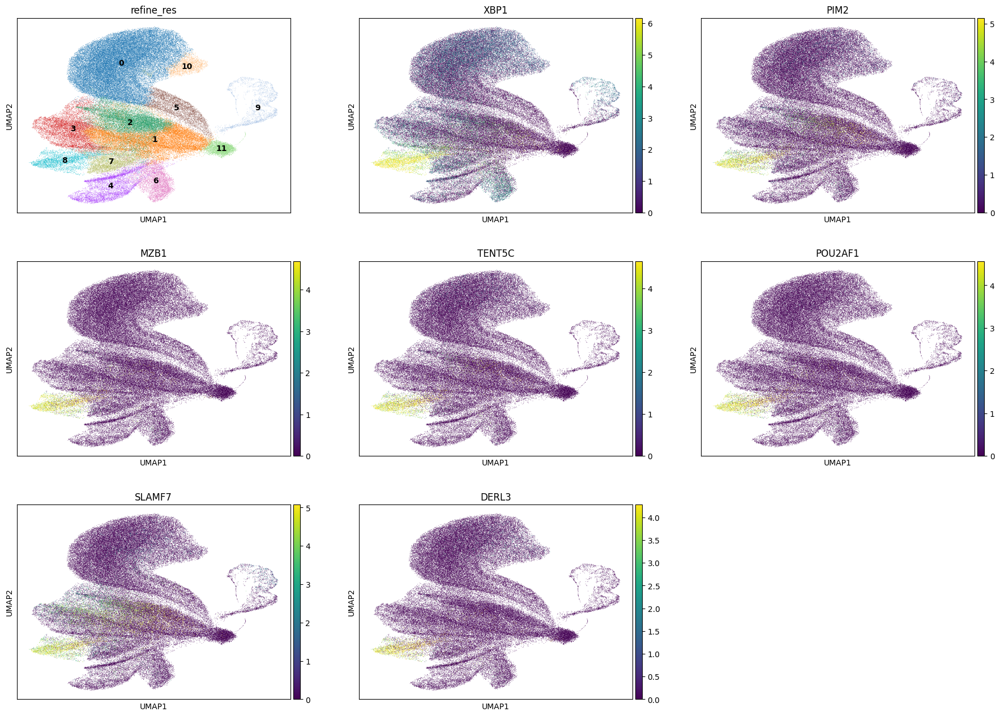

In [100]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [101]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 3577
Percentage of cells in cluster 8: 3.3


In [102]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.10. Cluster 9

In [103]:
cluster_id = '9'

In [104]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Keratinocyte,Keratinocyte,normal_cell,95.6
1,T,T_CD8,normal_cell,1.7
2,NA,NA,NA,0.8
3,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,0.8
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.6


In [105]:
top_ranked_genes[cluster_id]

0     CXADR
1      ST14
2      LAD1
3      DSG3
4      DSG1
5    SLC2A1
6     GSDMC
Name: 9, dtype: object

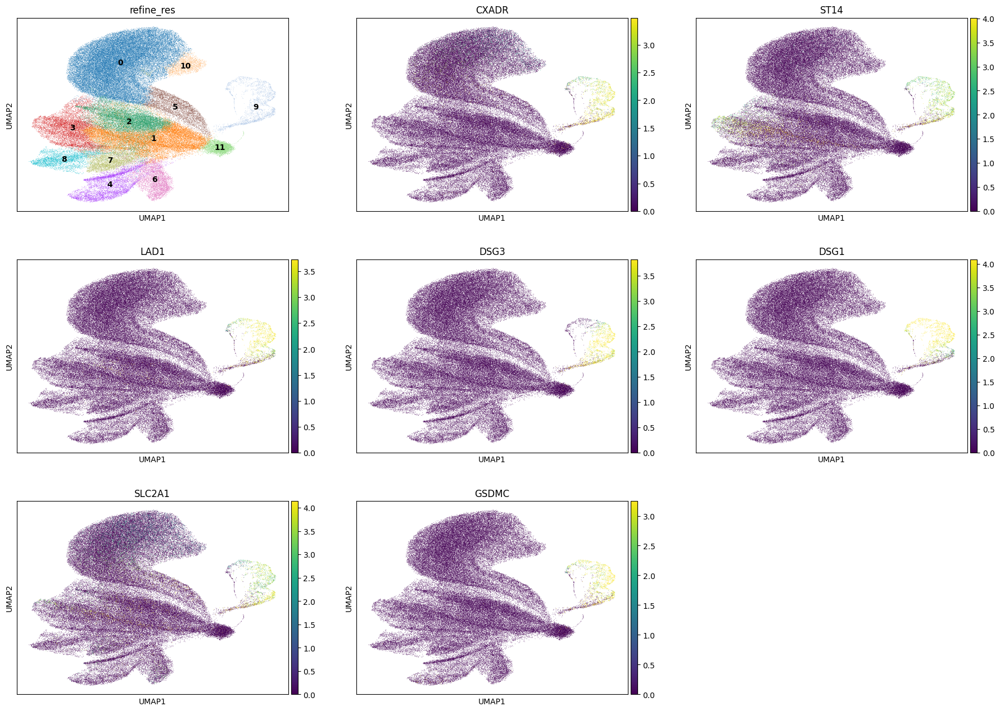

In [106]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [107]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 2492
Percentage of cells in cluster 9: 2.3


In [108]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

### 5.11. Cluster 10

In [109]:
cluster_id = '10'

In [110]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Melanoma,High_proliferating_melanoma,cancer_cell,92.7
1,Melanoma,Melanoma,cancer_cell,6.9
2,T,T_CD8,normal_cell,0.2
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.2
4,NA,NA,NA,0.1


In [111]:
top_ranked_genes[cluster_id]

0     BIRC5
1      TYMS
2     KPNA2
3    MAD2L1
4     PRR11
5     TOP2A
6     STMN1
Name: 10, dtype: object

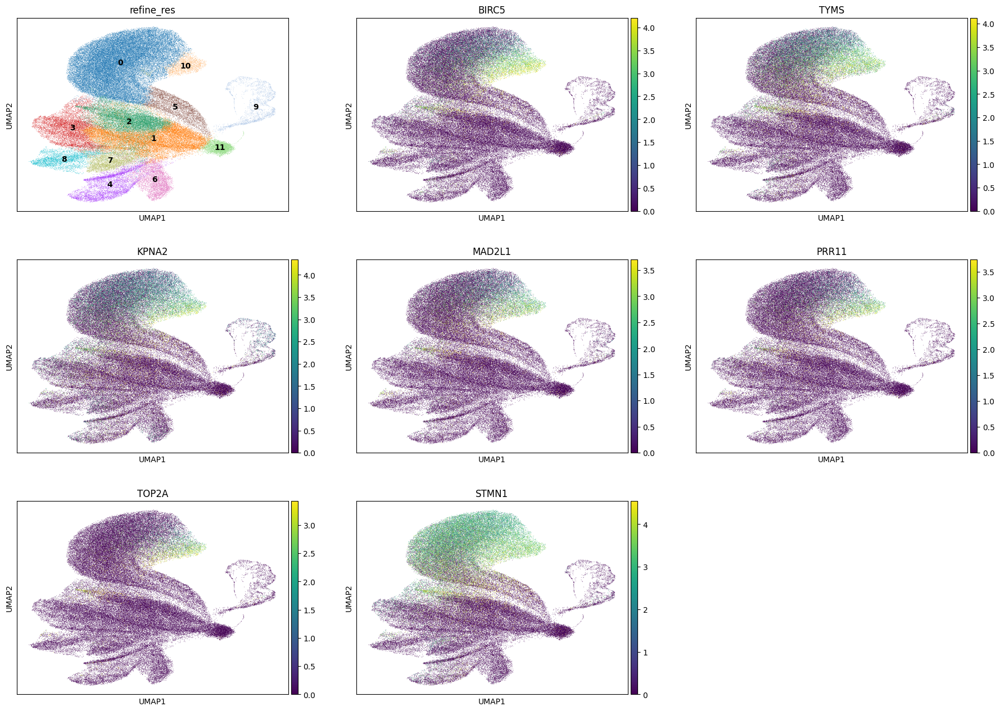

In [113]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [114]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 1932
Percentage of cells in cluster 10: 1.8


In [115]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'High_proliferating_melanocyte'

### 5.12. Cluster 11

In [116]:
cluster_id = '11'

In [117]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Cancer_stem_like_cells,Cancer_stem_like_cells,cancer_cell,60.7
1,NA,NA,NA,37.4
2,T,T_CD8,normal_cell,0.7
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.4
4,Keratinocyte,Keratinocyte,normal_cell,0.3


In [118]:
top_ranked_genes[cluster_id]

0    SOX2-OT
1       SOST
2      ALG11
3       DUX4
4     OSGIN1
5      ADRB1
6      POTEF
Name: 11, dtype: object

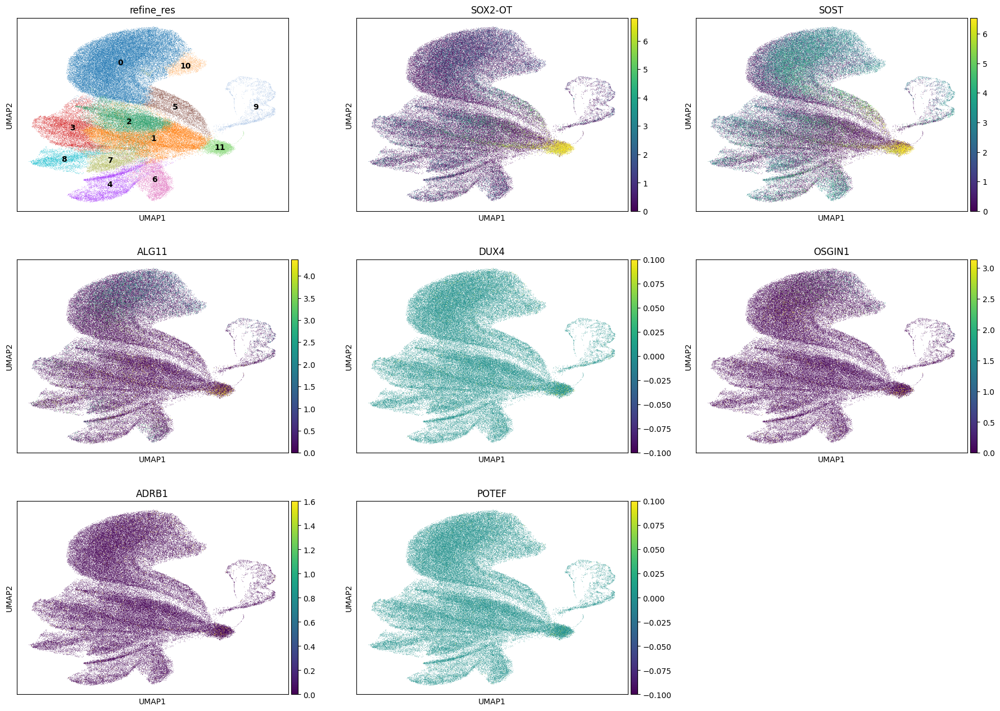

In [120]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [121]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 3686
Percentage of cells in cluster 11: 3.5


In [122]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Stem_like_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Stem_like_cell'

## 6. Cancer cells

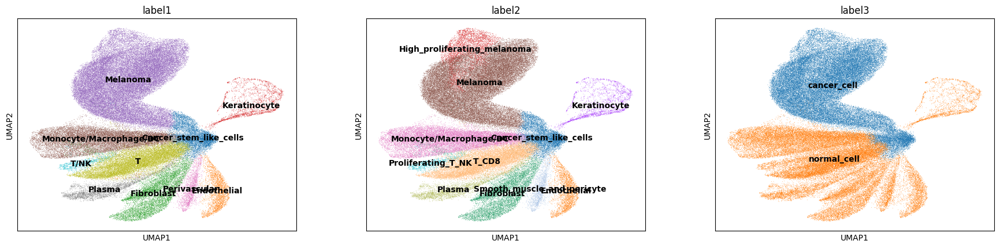

In [125]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

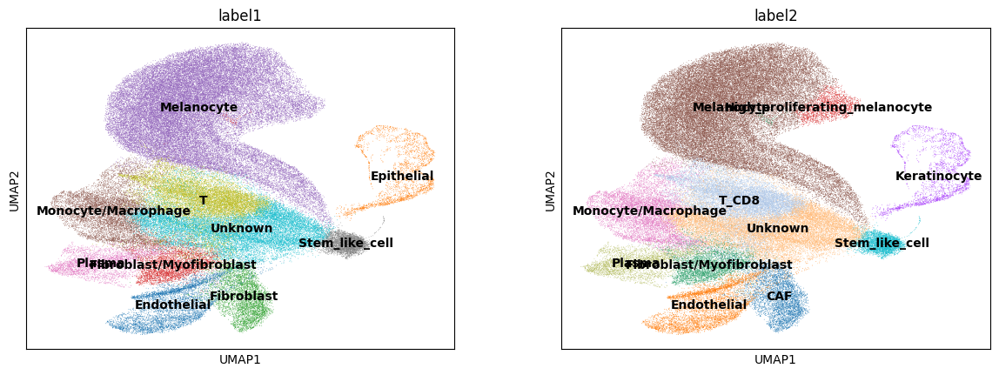

In [126]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [127]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Melanocyte', 'Stem_like_cell']), 'label3'] = 'cancer_cell'

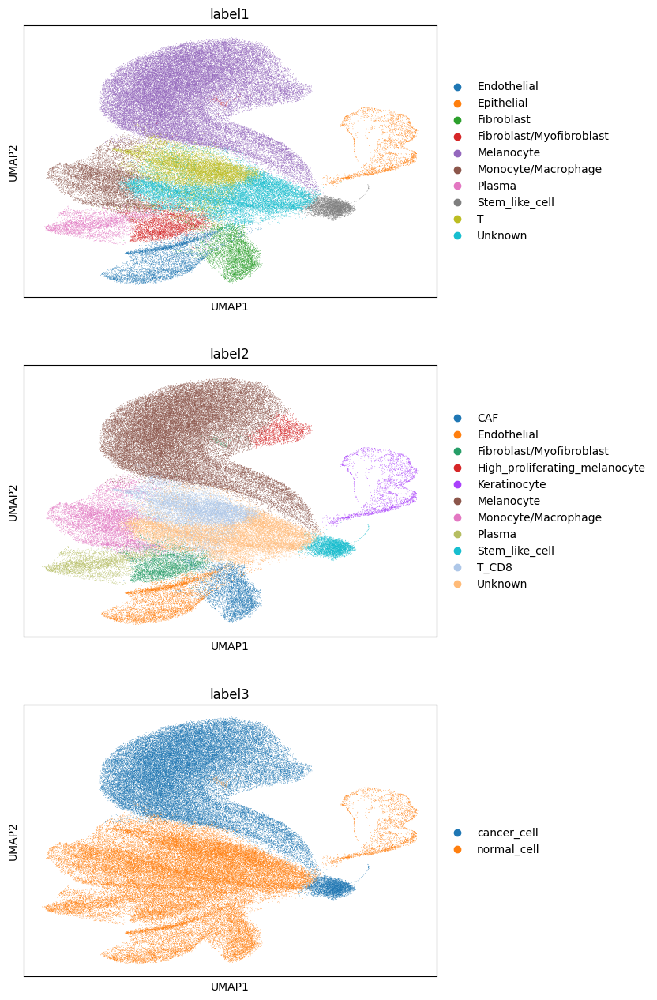

In [128]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [129]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,...,segmentation_method,region,z_level,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,2445,0,0,0,0,30,2475,489.719549,70.082503,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,12,18,9,Epithelial,Keratinocyte,normal_cell
1,aaaaaaab-1,2658,0,1,0,0,16,2675,333.162825,58.522502,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,12,18,9,Epithelial,Keratinocyte,normal_cell
2,aaaaaaac-1,1747,0,0,0,0,8,1755,254.274853,43.485470,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,12,18,9,Epithelial,Keratinocyte,normal_cell
3,aaaaaaad-1,1877,0,0,0,1,33,1911,332.666106,13.908126,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,12,18,9,Epithelial,Keratinocyte,normal_cell
9,aaaaaaae-1,1075,0,0,0,0,11,1086,199.184226,43.124220,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,12,18,9,Epithelial,Keratinocyte,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112544,aaabkmnm-1,11,0,0,0,0,0,11,8.308750,8.308750,...,Segmented by nucleus expansion of 5.0µm,cell_labels,4.0,1,1,1,1,Unknown,Unknown,normal_cell
112545,aaabkmnn-1,42,0,0,0,0,0,42,18.785001,14.901563,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,1,1,1,1,Unknown,Unknown,normal_cell
112546,aaabkmno-1,16,0,0,0,0,0,16,6.276719,6.276719,...,Segmented by nucleus expansion of 5.0µm,cell_labels,4.0,1,9,12,11,Stem_like_cell,Stem_like_cell,cancer_cell
112549,aaabkmob-1,139,0,0,0,0,0,139,65.115315,27.816251,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,2,2,3,2,T,T_CD8,normal_cell


In [130]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")